## Notebook for the generation of a batch-corrected manifold using `scVI` prior to `cellrank`

- **Developed by**: Carlos Talavera-López Ph.D
- **Institute of Computational Biology - Computational Health Centre - Helmholtz Munich**
- v230314

### Load required modules

In [1]:
import sys
import scvi
import torch
import anndata
import matplotlib
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap

import numpy as np
import scipy as sp
import pandas as pd
import scanpy as sc
import numpy.random as random
from scib_metrics.benchmark import Benchmarker

from umap import UMAP
import warnings; warnings.simplefilter('ignore')

Global seed set to 0


In [2]:
save_path = "../data/"

In [3]:
%matplotlib inline
matplotlib.rcParams["pdf.fonttype"] = 42
matplotlib.rcParams["ps.fonttype"] = 42

In [4]:
torch.cuda.is_available()

False

In [5]:
torch.set_float32_matmul_precision('medium')

In [6]:
sc.settings.verbosity = 3
sc.logging.print_versions()
sc.settings.set_figure_params(dpi = 180, color_map = 'magma_r', dpi_save = 300, vector_friendly = True, format = 'svg')

-----
anndata     0.8.0
scanpy      1.9.1
-----
PIL                 9.4.0
absl                NA
appnope             0.1.3
asttokens           NA
attr                22.2.0
backcall            0.2.0
brotli              NA
certifi             2022.12.07
cffi                1.15.1
charset_normalizer  2.1.1
chex                0.1.5
colorama            0.4.6
comm                0.1.2
contextlib2         NA
cycler              0.10.0
cython_runtime      NA
dateutil            2.8.2
debugpy             1.6.6
decorator           5.1.1
docrep              0.3.2
executing           1.2.0
flax                0.5.0
fsspec              2023.1.0
gmpy2               2.1.2
h5py                3.8.0
idna                3.4
igraph              0.10.4
ipykernel           6.21.1
ipywidgets          8.0.4
jax                 0.4.2
jaxlib              0.4.2
jedi                0.18.2
joblib              1.2.0
kiwisolver          1.4.4
leidenalg           0.9.1
lightning_fabric    1.9.0
lightning_utilities

In [7]:
def X_is_raw(adata):
    return np.array_equal(adata.X.sum(axis = 0).astype(int), adata.X.sum(axis = 0))

### Read in datasets

- Read in formatted object

In [8]:
adata_all = sc.read_h5ad('../data/Marburg_All_ctl230404_leiden_states.raw.h5ad')
adata_all

AnnData object with n_obs × n_vars = 97573 × 27208
    obs: 'sex', 'age', 'ethnicity', 'PaCO2', 'donor', 'infection', 'disease', 'SMK', 'illumina_stimunr', 'bd_rhapsody', 'n_genes', 'doublet_scores', 'predicted_doublets', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'n_counts', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', 'condition', 'sample_group', '_scvi_batch', '_scvi_labels', 'IAV_score', 'group', 'C_scANVI', 'cell_type', 'leiden', 'leiden_states'
    var: 'mt', 'ribo', 'n_cells_by_counts-V1', 'mean_counts-V1', 'pct_dropout_by_counts-V1', 'total_counts-V1', 'n_cells_by_counts-V2', 'mean_counts-V2', 'pct_dropout_by_counts-V2', 'total_counts-V2', 'n_cells_by_counts-V3', 'mean_counts-V3', 'pct_dropout_by_counts-V3', 'total_counts-V3', 'n_cells_by_counts-V4', 'mean_counts-V4', 'pct_dropout_by_counts-V4', 'total_counts-V4', 'n_cells_by_counts-V5', 'mean_counts-V5', 'pct_dropout_by_coun

In [9]:
adata = adata_all[adata_all.obs['group'].isin(['copd_iav'])]
adata

View of AnnData object with n_obs × n_vars = 24958 × 27208
    obs: 'sex', 'age', 'ethnicity', 'PaCO2', 'donor', 'infection', 'disease', 'SMK', 'illumina_stimunr', 'bd_rhapsody', 'n_genes', 'doublet_scores', 'predicted_doublets', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'n_counts', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', 'condition', 'sample_group', '_scvi_batch', '_scvi_labels', 'IAV_score', 'group', 'C_scANVI', 'cell_type', 'leiden', 'leiden_states'
    var: 'mt', 'ribo', 'n_cells_by_counts-V1', 'mean_counts-V1', 'pct_dropout_by_counts-V1', 'total_counts-V1', 'n_cells_by_counts-V2', 'mean_counts-V2', 'pct_dropout_by_counts-V2', 'total_counts-V2', 'n_cells_by_counts-V3', 'mean_counts-V3', 'pct_dropout_by_counts-V3', 'total_counts-V3', 'n_cells_by_counts-V4', 'mean_counts-V4', 'pct_dropout_by_counts-V4', 'total_counts-V4', 'n_cells_by_counts-V5', 'mean_counts-V5', 'pct_dropout

In [10]:
X_is_raw(adata)

True

In [11]:
adata.obs['batch'].value_counts()

CSE03_IAV       5558
GnR_07_IAV      5279
CHE03_IAV       3935
CHE01_IAV       3625
CHE02_IAV       3374
ST10_GnR_IAV    3187
Name: batch, dtype: int64

### Calculate HVGs

In [12]:
adata_raw = adata.copy()
adata.layers['counts'] = adata.X.copy()

In [13]:
sc.pp.highly_variable_genes(
    adata,
    flavor = "seurat_v3",
    n_top_genes = 5000,
    layer = "counts",
    batch_key = "batch",
    subset = True
)
adata

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)


AnnData object with n_obs × n_vars = 24958 × 5000
    obs: 'sex', 'age', 'ethnicity', 'PaCO2', 'donor', 'infection', 'disease', 'SMK', 'illumina_stimunr', 'bd_rhapsody', 'n_genes', 'doublet_scores', 'predicted_doublets', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'n_counts', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', 'condition', 'sample_group', '_scvi_batch', '_scvi_labels', 'IAV_score', 'group', 'C_scANVI', 'cell_type', 'leiden', 'leiden_states'
    var: 'mt', 'ribo', 'n_cells_by_counts-V1', 'mean_counts-V1', 'pct_dropout_by_counts-V1', 'total_counts-V1', 'n_cells_by_counts-V2', 'mean_counts-V2', 'pct_dropout_by_counts-V2', 'total_counts-V2', 'n_cells_by_counts-V3', 'mean_counts-V3', 'pct_dropout_by_counts-V3', 'total_counts-V3', 'n_cells_by_counts-V4', 'mean_counts-V4', 'pct_dropout_by_counts-V4', 'total_counts-V4', 'n_cells_by_counts-V5', 'mean_counts-V5', 'pct_dropout_by_count

### Data integration with `scVI`

In [14]:
scvi.model.SCVI.setup_anndata(
    adata,
    layer = "counts",
    labels_key = "leiden_states",
    categorical_covariate_keys = ["batch", "donor"],
    continuous_covariate_keys = ["n_genes", "n_counts"]
)

In [15]:
model = scvi.model.SCVI(adata, n_layers = 3, n_latent = 50, gene_likelihood = "nb", dispersion = 'gene-batch')
model

SCVI Model with the following params: 
n_hidden: 128, n_latent: 50, n_layers: 3, dropout_rate: 0.1, dispersion: gene-batch, gene_likelihood: nb, 
latent_distribution: normal
Training status: Not Trained
Model's adata is minified?: False

In [16]:
model.train()

GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Epoch 321/321: 100%|██████████| 321/321 [32:05<00:00,  6.16s/it, loss=2.34e+03, v_num=1]

`Trainer.fit` stopped: `max_epochs=321` reached.


Epoch 321/321: 100%|██████████| 321/321 [32:05<00:00,  6.00s/it, loss=2.34e+03, v_num=1]


In [17]:
latent = model.get_latent_representation()
adata.obsm["X_scVI"] = latent

computing neighbors


OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:10)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:15)


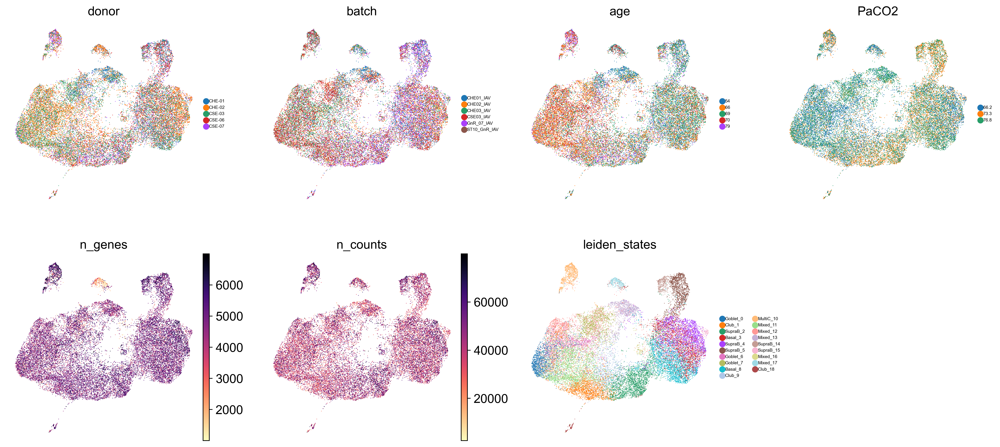

In [18]:
sc.pp.neighbors(adata, use_rep = "X_scVI", n_neighbors = 50, metric = 'minkowski')
sc.tl.umap(adata, min_dist = 0.3, spread = 4, random_state = 1712)
sc.pl.umap(adata, frameon = False, color = ['donor', 'batch','age', 'PaCO2', 'n_genes', 'n_counts', 'leiden_states'], size = 2, legend_fontsize = 5, ncols = 4)

### Score IAV genes across manifold

In [20]:
adata_log = adata.copy()

sc.pp.normalize_total(adata_log, target_sum = 1e6, exclude_highly_expressed = True)
sc.pp.log1p(adata_log)
adata_log.layers["sqrt_norm"] = np.sqrt(
    sc.pp.normalize_total(adata_log, inplace = False)["X"]
)

normalizing counts per cell The following highly-expressed genes are not considered during normalization factor computation:
['AGR2', 'ALDH1A1', 'ANXA1', 'AQP3', 'B2M', 'BPIFA1', 'BPIFB1', 'CAV1', 'CCL20', 'CD74', 'CLU', 'CXCL1', 'CXCL10', 'CXCL11', 'CXCL17', 'CXCL8', 'DLG1', 'DST', 'FN1', 'GDF15', 'GLUL', 'GTF2IRD1', 'HSP90AA1', 'HSPB1', 'IFI6', 'IFIT2', 'IGFBP3', 'IL1B', 'ISG15', 'ITGB1', 'KRT13', 'KRT17', 'KRT4', 'KRT5', 'KRT6A', 'LAMC2', 'LCN2', 'MALAT1', 'MMP13', 'MMP7', 'MSMB', 'MT1X', 'MT2A', 'MTRNR2L12', 'NC_026431.1', 'NC_026432.1', 'NC_026433.1', 'NC_026434.1', 'NC_026435.1', 'NC_026436.1', 'NC_026437.1', 'NC_026438.1', 'NEAT1', 'NREP', 'PSCA', 'S100A2', 'S100A6', 'S100A7', 'S100A8', 'S100A9', 'SAA1', 'SAA2', 'SAT1', 'SCGB1A1', 'SCGB3A1', 'SELENOP', 'SERPINB3', 'SERPINE1', 'SLC34A2', 'SLPI', 'STATH', 'THBS1', 'WFDC2']
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)


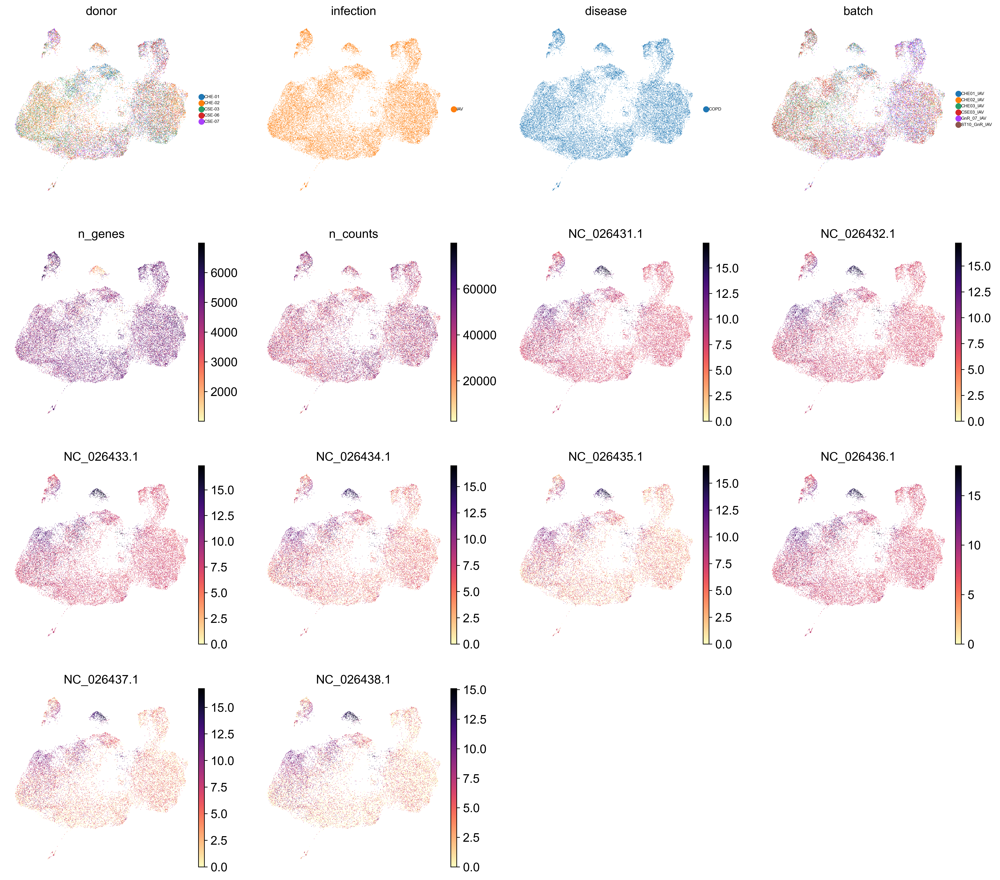

In [21]:
sc.pl.umap(adata_log, frameon = False, color = ['donor', 'infection', 'disease', 'batch', 'n_genes', 'n_counts', 'NC_026431.1','NC_026432.1','NC_026433.1','NC_026434.1','NC_026435.1','NC_026436.1','NC_026437.1','NC_026438.1'], size = 1, legend_fontsize = 5, ncols = 4)

computing score 'IAV_score'
    finished: added
    'IAV_score', score of gene set (adata.obs).
    147 total control genes are used. (0:00:00)


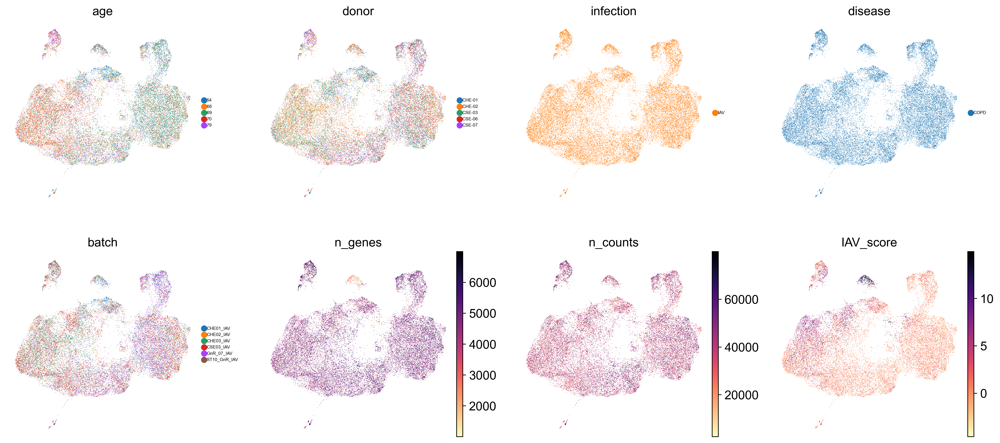

In [22]:
iav_genes = ['NC_026431.1','NC_026432.1','NC_026433.1','NC_026434.1','NC_026435.1','NC_026436.1','NC_026437.1','NC_026438.1']
sc.tl.score_genes(adata_log, iav_genes, score_name = 'IAV_score', random_state = 1712)
sc.pl.umap(adata_log, frameon = False, color = ['age', 'donor', 'infection', 'disease', 'batch', 'n_genes', 'n_counts', 'IAV_score'], size = 1, legend_fontsize = 5, ncols = 4)

In [23]:
adata.obs['IAV_score'] = adata_log.obs['IAV_score'].copy()

In [24]:
adata

AnnData object with n_obs × n_vars = 24958 × 5000
    obs: 'sex', 'age', 'ethnicity', 'PaCO2', 'donor', 'infection', 'disease', 'SMK', 'illumina_stimunr', 'bd_rhapsody', 'n_genes', 'doublet_scores', 'predicted_doublets', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'n_counts', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', 'condition', 'sample_group', '_scvi_batch', '_scvi_labels', 'IAV_score', 'group', 'C_scANVI', 'cell_type', 'leiden', 'leiden_states'
    var: 'mt', 'ribo', 'n_cells_by_counts-V1', 'mean_counts-V1', 'pct_dropout_by_counts-V1', 'total_counts-V1', 'n_cells_by_counts-V2', 'mean_counts-V2', 'pct_dropout_by_counts-V2', 'total_counts-V2', 'n_cells_by_counts-V3', 'mean_counts-V3', 'pct_dropout_by_counts-V3', 'total_counts-V3', 'n_cells_by_counts-V4', 'mean_counts-V4', 'pct_dropout_by_counts-V4', 'total_counts-V4', 'n_cells_by_counts-V5', 'mean_counts-V5', 'pct_dropout_by_count

In [25]:
X_is_raw(adata)

True

In [26]:
adata.X = sp.sparse.csc_matrix(adata.X)

In [28]:
adata.write('/Volumes/XF-11/working_datasets/marburg/working_objects/individual_conditions/Marburg_COPD-IAV_scVI-annotated_ctl230417.h5ad')